<a href="https://colab.research.google.com/github/Ritchie3/Invilab_4.0_Workshop/blob/main/Pytorch_Transfer_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# Workshop 28/04/2024
 
<img src="https://invilab.be/downloads/logo_white_HQ.png" width="500">

# Object Detection with a custom dataset in Pytorch

This Google Colab notebook demonstrates the process of training an object detection network using a manually annotated dataset created using [CVAT](https://www.cvat.ai/).

Object detection is a computer vision task that involves identifying and localizing objects within an image or video. Transfer learning, on the other hand, is a technique that allows us to reuse pre-trained models trained on large-scale datasets to solve new tasks with limited labeled data.

In this notebook, we will be using a popular deep learning framework, PyTorch, to implement transfer learning for object detection. We will start with a pre-trained model, typically trained on a large dataset such as COCO (Common Objects in Context), and fine-tune it on our specific dataset, which has been manually annotated using CVAT.

CVAT is a powerful annotation tool that enables us to label objects in images or videos with bounding boxes, polygons, or keypoints. By manually annotating our dataset, we can provide ground truth labels that are crucial for training an accurate object detection model.

The steps involved in this notebook include:
1. Preparing the dataset: Organizing the annotated dataset in a suitable format for training the model.
2. Setting up the deep learning framework and installing any required dependencies.
3. Loading the pre-trained model: Importing a pre-trained model, such as Faster R-CNN or YOLO, that has been pre-trained on a large-scale dataset.
4. Fine-tuning the model: Training the model on our annotated dataset, allowing it to learn to detect objects specific to our task.
5. Evaluating the model: Assessing the performance of the trained model on a validation set or testing dataset.
6. Inference: Applying the trained model to new images or videos to detect objects in real-world scenarios.

By following along with this notebook, you will gain a practical understanding of how to use transfer learning for object detection and how to leverage the power of manually annotated datasets created using CVAT. 

## 0. Set up environment

This code block imports the necessary python modules and mounts your Google Drive in Colab to access your data files.

When running this code block, you will be prompted to authorize access to your Google Drive. Follow the instructions provided and enter the authorization code to mount your drive.

The mounted Google Drive allows you to easily load and save files during your Colab session, providing convenient access to your data.

In [2]:
import os
import torch
import torch.utils.data
import torchvision
from PIL import Image
from pycocotools.coco import COCO
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import random_split
from tqdm import tqdm
from torch.utils.tensorboard import SummaryWriter
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.models.detection import FasterRCNN

dataset_dir = '/content/Dataset'
image_data_dir = os.path.join(dataset_dir, 'images')
annotations_dir = os.path.join(dataset_dir, 'annotations')
annotations_json = os.path.join(annotations_dir,'instances_default.json')

os.makedirs(dataset_dir, exist_ok=True)
os.makedirs(annotations_dir, exist_ok=True)
os.makedirs(image_data_dir, exist_ok=True)



## Creating Dataset and DataLoader

In this code block, we create our own custom dataset and set up a data loader for training our object detection network.

1. **Creating the Dataset:** We instantiate `CVATDataset`, our custom dataset class, by passing the `root` directory of the dataset, the `annotation` file, and the desired `transforms`. This dataset class is responsible for loading images and their corresponding annotations.

2. **Removing Images Without Annotations:** To ensure that our training dataset contains only images with relevant annotations, we call `coco_remove_images_without_annotations` function. It takes the `my_dataset` as input and removes any images that do not have valid annotations. This helps us maintain a high-quality dataset for training.

3. **Setting the Batch Size:** We define the `train_batch_size` variable to determine the number of samples per batch during training. Adjust this value based on your available resources and the model's memory requirements.

4. **Creating the DataLoader:** Finally, we create the `data_loader` using `torch.utils.data.DataLoader`. It takes the `dataset` object, the `batch_size`, `shuffle=True` for randomizing the order of samples, `num_workers` for parallel data loading, and `collate_fn` for defining how to collate the batch.

By creating a custom dataset and setting up the data loader, we ensure that our data is efficiently loaded and processed in batches during training, facilitating the training of our object detection network.


In [3]:
class CVATDataset(torch.utils.data.Dataset):
    def __init__(self, root, annotation, transforms=None):
        self.root = root
        self.transforms = transforms
        self.coco = COCO(annotation)
        self.ids = list(sorted(self.coco.imgs.keys()))

    def __getitem__(self, index):
        # Own coco file
        coco = self.coco
        # Image ID
        img_id = self.ids[index]
        # List: get annotation id from coco
        ann_ids = coco.getAnnIds(imgIds=img_id)
        # Dictionary: target coco_annotation file for an image
        coco_annotation = coco.loadAnns(ann_ids)
        # path for input image
        path = coco.loadImgs(img_id)[0]['file_name']
        # open the input image
        img = Image.open(os.path.join(self.root, path))

        # number of objects in the image
        num_objs = len(coco_annotation)

        # Bounding boxes for objects
        # In coco format, bbox = [xmin, ymin, width, height]
        # In pytorch, the input should be [xmin, ymin, xmax, ymax]
        boxes = []
        for i in range(num_objs):
            xmin = coco_annotation[i]['bbox'][0]
            ymin = coco_annotation[i]['bbox'][1]
            xmax = xmin + coco_annotation[i]['bbox'][2]
            ymax = ymin + coco_annotation[i]['bbox'][3]
            boxes.append([xmin, ymin, xmax, ymax])
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        # Labels (In my case, I only one class: target class or background)
        labels = torch.ones((num_objs,), dtype=torch.int64)
        # Tensorise img_id
        img_id = torch.tensor([img_id])
        # Size of bbox (Rectangular)
        areas = []
        for i in range(num_objs):
            areas.append(coco_annotation[i]['area'])
        areas = torch.as_tensor(areas, dtype=torch.float32)
        # Iscrowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        # Annotation is in dictionary format
        my_annotation = {}
        my_annotation["boxes"] = boxes
        my_annotation["labels"] = labels
        my_annotation["image_id"] = img_id
        my_annotation["area"] = areas
        my_annotation["iscrowd"] = iscrowd

        if self.transforms is not None:
            img = self.transforms(img)

        return img, my_annotation

    def __len__(self):
        return len(self.ids)

def collate_fn(batch):
    return tuple(zip(*batch))

def coco_remove_images_without_annotations(dataset, cat_list=None):
    def _has_only_empty_bbox(anno):
        return all(any(o <= 1 for o in obj["bbox"][2:]) for obj in anno)

    def _count_visible_keypoints(anno):
        return sum(sum(1 for v in ann["keypoints"][2::3] if v > 0) for ann in anno)

    min_keypoints_per_image = 10

    def _has_valid_annotation(anno):
        # if it's empty, there is no annotation
        if len(anno) == 0:
            return False
        # if all boxes have close to zero area, there is no annotation
        if _has_only_empty_bbox(anno):
            return False
        # keypoints task have a slight different critera for considering
        # if an annotation is valid
        if "keypoints" not in anno[0]:
            return True
        # for keypoint detection tasks, only consider valid images those
        # containing at least min_keypoints_per_image
        if _count_visible_keypoints(anno) >= min_keypoints_per_image:
            return True
        return False

    # assert isinstance(dataset, torchvision.datasets.CocoDetection)
    ids = []
    for ds_idx, img_id in enumerate(dataset.ids):
        ann_ids = dataset.coco.getAnnIds(imgIds=img_id, iscrowd=None)
        anno = dataset.coco.loadAnns(ann_ids)
        if cat_list:
            anno = [obj for obj in anno if obj["category_id"] in cat_list]
        if _has_valid_annotation(anno):
            ids.append(ds_idx)

    dataset = torch.utils.data.Subset(dataset, ids)
    return dataset
    
def get_transform():
    custom_transforms = []
    custom_transforms.append(torchvision.transforms.ToTensor())
    return torchvision.transforms.Compose(custom_transforms)

# create own Dataset
my_dataset = CVATDataset(root=image_data_dir,
                          annotation=annotations_json,
                          transforms=get_transform()
                          )

# collate_fn needs for batch
dataset = coco_remove_images_without_annotations(my_dataset)

# Define the ratios for train, test, and validation sets
train_ratio = 0.8  #@param {type:"number"}
test_ratio = 0.1  #@param {type:"number"}
validation_ratio = 0.1  #@param {type:"number"}

# Extra check
total_ratio = train_ratio + test_ratio + validation_ratio

if abs(total_ratio - 1) > 0.0001:
    print("Warning: Ratios do not add up to 1. Using default values.")
    train_ratio = 0.8
    test_ratio = 0.1
    validation_ratio = 0.1

# Split the dataset into train, test, and validation sets
train_size = int(train_ratio * len(dataset))
test_size = int(test_ratio * len(dataset))
validation_size = len(dataset) - train_size - test_size

train_dataset, test_dataset, validation_dataset = random_split(dataset, [train_size, test_size, validation_size])

# Batch size
train_batch_size = 2

# Create data loaders for train, test, and validation sets
train_loader = torch.utils.data.DataLoader(train_dataset,
                                           batch_size=train_batch_size,
                                           shuffle=True,
                                           num_workers=2,
                                           collate_fn=collate_fn)

test_loader = torch.utils.data.DataLoader(test_dataset,
                                          batch_size=train_batch_size,
                                          shuffle=False,
                                          num_workers=2,
                                          collate_fn=collate_fn)

validation_loader = torch.utils.data.DataLoader(validation_dataset,
                                                batch_size=train_batch_size,
                                                shuffle=False,
                                                num_workers=2,
                                                collate_fn=collate_fn)

data_loaders = {
    "Train": train_loader,
    "Test": test_loader,
    "Validation": validation_loader
}

print("Data Loader Information:")
print("------------------------")

for split, loader in data_loaders.items():
    dataset_size = len(loader.dataset)
    batch_size = loader.batch_size
    num_batches = len(loader)
    
    print(f"{split} Dataset Size: {dataset_size}")
    print(f"{split} Batch Size: {batch_size}")
    print(f"Number of {split} Batches: {num_batches}")
    print("------------------------")



loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Data Loader Information:
------------------------
Train Dataset Size: 25
Train Batch Size: 2
Number of Train Batches: 13
------------------------
Test Dataset Size: 3
Test Batch Size: 2
Number of Test Batches: 2
------------------------
Validation Dataset Size: 4
Validation Batch Size: 2
Number of Validation Batches: 2
------------------------


In [4]:
%load_ext tensorboard
%tensorboard --logdir=runs


<IPython.core.display.Javascript object>

## Training Configuration

In this code cell, we configure the training parameters for our model.

- `num_epochs` is set to `20`, which represents the number of times the entire training dataset will be passed through the model during training.

- `num_classes` is set to `2`, indicating the number of classes in our classification problem. This typically includes the target class and the background class.

These parameters will be used in subsequent code cells to train a model and evaluate its performance.


In [7]:
num_epochs = 40 #@param {type:"number"}
num_classes = 2 #@param {type:"number"}

The code in this cell demonstrates the training process for an instance segmentation model using the Faster R-CNN architecture.

1. **Defining the Model:** The `get_model_instance_segmentation` function is defined to create an instance segmentation model. It loads a pre-trained Faster R-CNN model and replaces the head with a new one to match the desired number of classes.

2. **Setting up the Model:** We specify the number of classes (`num_classes`) as 2 (target class or background) and the number of training epochs (`num_epochs`) as 10. The `get_model_instance_segmentation` function is called to initialize the model.

3. **Moving the Model to the Device:** The model is moved to the appropriate device (e.g., GPU) for training using the `to(device)` method.

4. **Defining Optimizer and Parameters:** The optimizer is defined as SGD (Stochastic Gradient Descent) with specific learning rate, momentum, and weight decay parameters. The trainable parameters of the model are selected using `model.parameters()` and stored in `params`.

5. **Training Loop:** The training loop begins with an outer loop over the specified number of epochs. Within each epoch, the model is set to training mode (`model.train()`). Then, an inner loop iterates over the data loader, retrieving batches of images and annotations.

6. **Moving Data to the Device:** The images and annotations are moved to the same device as the model (`imgs` to `device`). The annotations are converted to a list of dictionaries, ensuring all tensors are on the device.

7. **Forward Pass and Loss Computation:** The forward pass of the model is performed using `model(imgs, annotations)`, and the resulting losses are computed. The losses are accumulated and summed across all loss components.

8. **Backpropagation and Optimization:** The optimizer's gradients are reset (`optimizer.zero_grad()`), and the losses are backpropagated through the model (`losses.backward()`). Finally, the optimizer updates the model's parameters based on the computed gradients (`optimizer.step()`).

9. **Logging Progress:** Within the inner loop, the iteration number and loss value are printed to monitor the training progress.

This code cell demonstrates the training process, iterating over the data loader for a specified number of epochs, computing the loss, and updating the model's parameters.


In [8]:
def get_model_instance_segmentation(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model

model = get_model_instance_segmentation(num_classes)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# move the model to the right device
model.to(device)

# parameters
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# Create a SummaryWriter for TensorBoard logging
writer = SummaryWriter()

best_loss = float('inf')

# Define the total number of iterations
total_iterations = num_epochs * len(train_loader)

################################
# Starting the actual training
################################

for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0  # Accumulate the loss within the epoch
    loop = tqdm(train_loader)  # Create a progress bar for training iterations

    for imgs, annotations in loop:
        imgs = list(img.to(device) for img in imgs)  # Move images to the device
        annotations = [{k: v.to(device) for k, v in t.items()} for t in annotations]  # Move annotations to the device
        loss_dict = model(imgs, annotations)  # Forward pass: compute the loss
        losses = sum(loss for loss in loss_dict.values())  # Calculate the total loss
        epoch_loss += losses.item()  # Accumulate the loss within the epoch

        optimizer.zero_grad()  # Clear gradients
        losses.backward()  # Backward pass: compute gradients
        optimizer.step()  # Update model parameters using gradients

        loop.set_description(f"Epoch [{epoch}/{num_epochs}]")  # Update progress bar description
        loop.set_postfix(loss=losses.item())  # Update progress bar with current loss

    # Calculate average loss for the epoch
    average_loss = epoch_loss / len(train_loader)

    # # Check if the average loss is decreasing and save the model
    # if average_loss < best_loss:
    #     best_loss = average_loss
    #     torch.save(model.state_dict(), 'best_model.pth')

    print(f'\n Epoch: {epoch + 1}/{num_epochs}, Average Loss: {average_loss}')

    # Write average loss to TensorBoard
    writer.add_scalar('Loss/Train', average_loss, epoch + 1)

    # Log learning rate to TensorBoard
    current_lr = optimizer.param_groups[0]['lr']
    writer.add_scalar('Learning Rate', current_lr, epoch + 1)

    # Validation
    val_loss = 0.0
    with torch.no_grad():
        for val_imgs, val_annotations in validation_loader:
            val_imgs = list(img.to(device) for img in val_imgs)  # Move validation images to the device
            val_annotations = [{k: v.to(device) for k, v in t.items()} for t in val_annotations]  # Move validation annotations to the device
            val_loss_dict = model(val_imgs, val_annotations)  # Compute validation loss
            val_losses = sum(val_loss for val_loss in val_loss_dict.values())  # Calculate total validation loss
            val_loss += val_losses.item()  # Accumulate validation loss

    average_val_loss = val_loss / len(validation_loader)

    # # Check if the average validation loss is decreasing and save the model
    if average_val_loss < best_loss:
      best_loss = average_val_loss
      torch.save(model.state_dict(), 'best_model.pth')
      print('Validation loss has improved, saving model')

    print(f'Epoch: {epoch + 1}/{num_epochs}, Validation Loss: {average_val_loss} \n')

    # Write validation loss to TensorBoard
    writer.add_scalar('Loss/Validation', average_val_loss, epoch + 1)

print('\n Training completed.')

# Close the SummaryWriter
writer.close()


Epoch [0/40]: 100%|██████████| 13/13 [00:08<00:00,  1.55it/s, loss=0.219]



 Epoch: 1/40, Average Loss: 0.3978698941377493
Validation loss has improved, saving model
Epoch: 1/40, Validation Loss: 0.2571355700492859 



Epoch [1/40]: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s, loss=0.148]


 Epoch: 2/40, Average Loss: 0.22072126085941607


Validation loss has improved, saving model
Epoch: 2/40, Validation Loss: 0.23643583059310913 



Epoch [2/40]: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s, loss=0.15]



 Epoch: 3/40, Average Loss: 0.19092857665740526
Validation loss has improved, saving model
Epoch: 3/40, Validation Loss: 0.22996443510055542 



Epoch [3/40]: 100%|██████████| 13/13 [00:08<00:00,  1.46it/s, loss=0.18]


 Epoch: 4/40, Average Loss: 0.18917847482057717


Validation loss has improved, saving model
Epoch: 4/40, Validation Loss: 0.17629437893629074 



Epoch [4/40]: 100%|██████████| 13/13 [00:08<00:00,  1.52it/s, loss=0.0861]



 Epoch: 5/40, Average Loss: 0.17212307567779833
Epoch: 5/40, Validation Loss: 0.1853400617837906 



Epoch [5/40]: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s, loss=0.118]


 Epoch: 6/40, Average Loss: 0.14468934386968613


Validation loss has improved, saving model
Epoch: 6/40, Validation Loss: 0.1453757882118225 



Epoch [6/40]: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s, loss=0.0477]


 Epoch: 7/40, Average Loss: 0.12882111680049163


Epoch: 7/40, Validation Loss: 0.1643618792295456 



Epoch [7/40]: 100%|██████████| 13/13 [00:08<00:00,  1.57it/s, loss=0.0631]



 Epoch: 8/40, Average Loss: 0.1067372104869439
Epoch: 8/40, Validation Loss: 0.19414902478456497 



Epoch [8/40]: 100%|██████████| 13/13 [00:08<00:00,  1.51it/s, loss=0.0808]



 Epoch: 9/40, Average Loss: 0.10013907746626781
Validation loss has improved, saving model
Epoch: 9/40, Validation Loss: 0.11546885222196579 



Epoch [9/40]: 100%|██████████| 13/13 [00:08<00:00,  1.58it/s, loss=0.0569]



 Epoch: 10/40, Average Loss: 0.07861400309663552
Epoch: 10/40, Validation Loss: 0.1648208238184452 



Epoch [10/40]: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s, loss=0.0288]



 Epoch: 11/40, Average Loss: 0.06915671937167645
Epoch: 11/40, Validation Loss: 0.1289707086980343 



Epoch [11/40]: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s, loss=0.0487]


 Epoch: 12/40, Average Loss: 0.06945548550440715


Epoch: 12/40, Validation Loss: 0.13487599603831768 



Epoch [12/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.197]



 Epoch: 13/40, Average Loss: 0.07409468121253528
Epoch: 13/40, Validation Loss: 0.12647553719580173 



Epoch [13/40]: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s, loss=0.0147]



 Epoch: 14/40, Average Loss: 0.05884213602313629
Epoch: 14/40, Validation Loss: 0.15000891871750355 



Epoch [14/40]: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s, loss=0.198]



 Epoch: 15/40, Average Loss: 0.07063559571710917
Epoch: 15/40, Validation Loss: 0.1432651448994875 



Epoch [15/40]: 100%|██████████| 13/13 [00:08<00:00,  1.53it/s, loss=0.114]


 Epoch: 16/40, Average Loss: 0.07127075513394979


Epoch: 16/40, Validation Loss: 0.14309473522007465 



Epoch [16/40]: 100%|██████████| 13/13 [00:08<00:00,  1.53it/s, loss=0.0616]


 Epoch: 17/40, Average Loss: 0.05882820085837291


Epoch: 17/40, Validation Loss: 0.15744690783321857 



Epoch [17/40]: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s, loss=0.0235]


 Epoch: 18/40, Average Loss: 0.06865197849961427


Validation loss has improved, saving model
Epoch: 18/40, Validation Loss: 0.11000351049005985 



Epoch [18/40]: 100%|██████████| 13/13 [00:07<00:00,  1.67it/s, loss=0.145]



 Epoch: 19/40, Average Loss: 0.06566520336155708
Epoch: 19/40, Validation Loss: 0.12420633435249329 



Epoch [19/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.0513]



 Epoch: 20/40, Average Loss: 0.07907888837731801
Epoch: 20/40, Validation Loss: 0.17840295284986496 



Epoch [20/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.192]


 Epoch: 21/40, Average Loss: 0.08852484678992859


Epoch: 21/40, Validation Loss: 0.12492009997367859 



Epoch [21/40]: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s, loss=0.0248]


 Epoch: 22/40, Average Loss: 0.06943662679539277


Epoch: 22/40, Validation Loss: 0.1281763594597578 



Epoch [22/40]: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s, loss=0.0295]


 Epoch: 23/40, Average Loss: 0.0519011695511066


Validation loss has improved, saving model
Epoch: 23/40, Validation Loss: 0.09052692912518978 



Epoch [23/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.011]



 Epoch: 24/40, Average Loss: 0.049109952022823006
Epoch: 24/40, Validation Loss: 0.13559423107653856 



Epoch [24/40]: 100%|██████████| 13/13 [00:08<00:00,  1.56it/s, loss=0.0471]



 Epoch: 25/40, Average Loss: 0.04524274349499207
Epoch: 25/40, Validation Loss: 0.10883218608796597 



Epoch [25/40]: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s, loss=0.0177]


 Epoch: 26/40, Average Loss: 0.04230046773759218


Epoch: 26/40, Validation Loss: 0.11558181419968605 



Epoch [26/40]: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s, loss=0.0171]


 Epoch: 27/40, Average Loss: 0.046063451239695914


Epoch: 27/40, Validation Loss: 0.14563503116369247 



Epoch [27/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.0172]



 Epoch: 28/40, Average Loss: 0.05529779396378077
Epoch: 28/40, Validation Loss: 0.18478473275899887 



Epoch [28/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.0152]


 Epoch: 29/40, Average Loss: 0.041415135662716165


Epoch: 29/40, Validation Loss: 0.1407101582735777 



Epoch [29/40]: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s, loss=0.0188]


 Epoch: 30/40, Average Loss: 0.0331768668614901


Epoch: 30/40, Validation Loss: 0.1485319435596466 



Epoch [30/40]: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s, loss=0.0115]



 Epoch: 31/40, Average Loss: 0.031124463877998866
Epoch: 31/40, Validation Loss: 0.15026383567601442 



Epoch [31/40]: 100%|██████████| 13/13 [00:08<00:00,  1.51it/s, loss=0.0105]


 Epoch: 32/40, Average Loss: 0.023051416214842062


Epoch: 32/40, Validation Loss: 0.1350685292854905 



Epoch [32/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.0645]


 Epoch: 33/40, Average Loss: 0.02619042584242729


Epoch: 33/40, Validation Loss: 0.12077812105417252 



Epoch [33/40]: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s, loss=0.00615]


 Epoch: 34/40, Average Loss: 0.020364586371355332


Epoch: 34/40, Validation Loss: 0.12718568369746208 



Epoch [34/40]: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s, loss=0.00652]


 Epoch: 35/40, Average Loss: 0.018011720922703926


Epoch: 35/40, Validation Loss: 0.1674205493181944 



Epoch [35/40]: 100%|██████████| 13/13 [00:08<00:00,  1.50it/s, loss=0.0106]


 Epoch: 36/40, Average Loss: 0.017543523858946104


Epoch: 36/40, Validation Loss: 0.12323933281004429 



Epoch [36/40]: 100%|██████████| 13/13 [00:08<00:00,  1.55it/s, loss=0.00705]


 Epoch: 37/40, Average Loss: 0.019970517211522047


Epoch: 37/40, Validation Loss: 0.14945118594914675 



Epoch [37/40]: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s, loss=0.0222]


 Epoch: 38/40, Average Loss: 0.02833601674781396


Epoch: 38/40, Validation Loss: 0.14002604503184557 



Epoch [38/40]: 100%|██████████| 13/13 [00:07<00:00,  1.67it/s, loss=0.00853]


 Epoch: 39/40, Average Loss: 0.027708982439854972


Epoch: 39/40, Validation Loss: 0.11993355676531792 



Epoch [39/40]: 100%|██████████| 13/13 [00:08<00:00,  1.54it/s, loss=0.0175]



 Epoch: 40/40, Average Loss: 0.024746706458525017
Epoch: 40/40, Validation Loss: 0.19028385449200869 


 Training completed.


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


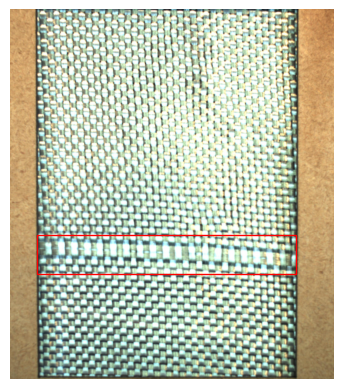

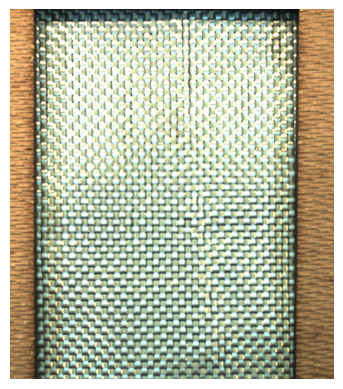

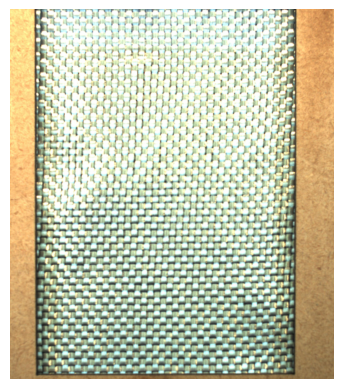

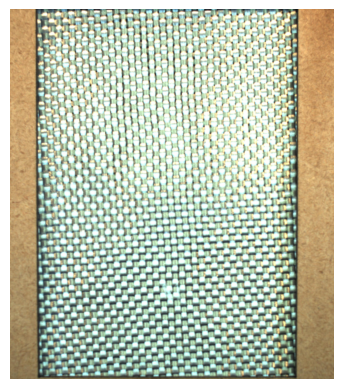

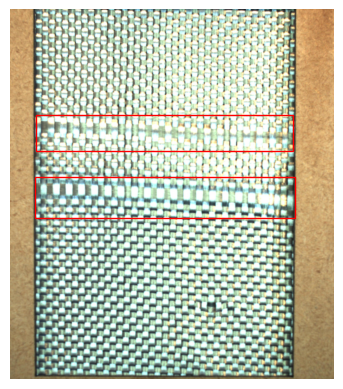

...

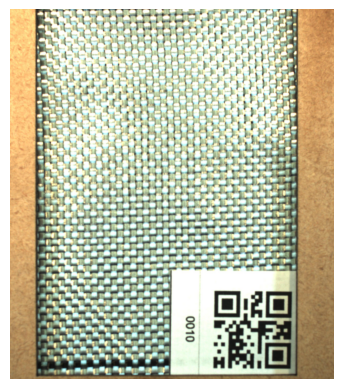

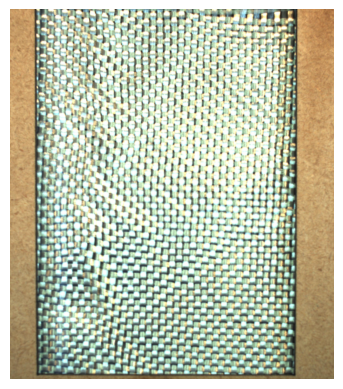

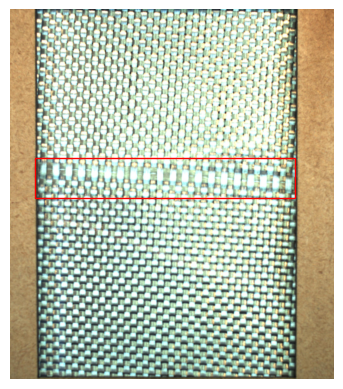

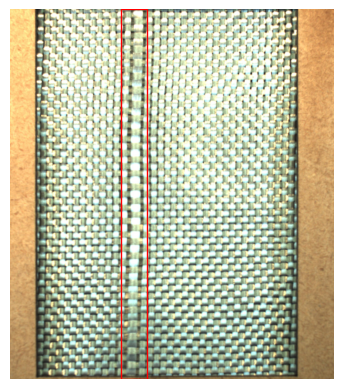

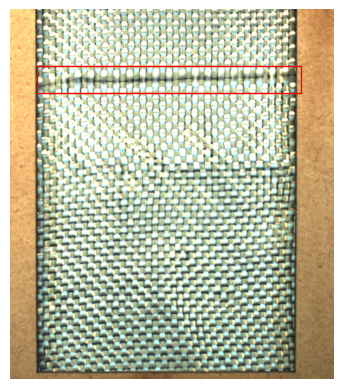

In [14]:
# Load the best model for inference
inference_model = get_model_instance_segmentation(num_classes)
inference_model.load_state_dict(torch.load('best_model.pth'))
inference_model.to(device)

# Prepare the new image for inference
image_name = '0003_hypercube.jpg' #@param {type:"string"}
pred_image_path = os.path.join(image_data_dir,image_name )
threshold = 0.8 #@param {type:"number"}
new_image = Image.open(pred_image_path)
new_image_tensor = get_transform()(new_image).unsqueeze(0).to(device)

# Set the model to evaluation mode
inference_model.eval()

# Perform inference on the new image
with torch.no_grad():
    predictions = inference_model(new_image_tensor)


import matplotlib.pyplot as plt

# Function to plot bounding boxes on the image
def plot_bounding_boxes(image, predictions):
    # Get the image dimensions
    image_width, image_height = image.size

    # Create a figure and axes
    fig, ax = plt.subplots(1)

    # Plot the image
    ax.imshow(image)

    # Delete axis
    ax.axis('off')

    # Plot the bounding boxes
    for i, pred in enumerate(predictions['boxes']):
      if predictions['scores'][i].tolist()>threshold:
        # Get the coordinates of the bounding box
        xmin, ymin, xmax, ymax = pred.tolist()

        # Calculate the width and height of the bounding box
        width = xmax - xmin
        height = ymax - ymin

        # Create a rectangle patch for the bounding box
        rect = plt.Rectangle((xmin, ymin), width, height, fill=False, edgecolor='red')

        # Add the rectangle patch to the axes
        ax.add_patch(rect)

    # Show the plot
    plt.show()

# Call the function to plot bounding boxes on the new image
# plot_bounding_boxes(new_image, predictions[0])

listdir = os.listdir(image_data_dir)

for im in listdir:
  threshold = 0.8 #@param {type:"number"}
  pred_image_path = os.path.join(image_data_dir,im )
  new_image = Image.open(pred_image_path)
  new_image_tensor = get_transform()(new_image).unsqueeze(0).to(device)
  with torch.no_grad():
    predictions = inference_model(new_image_tensor)
  plot_bounding_boxes(new_image, predictions[0])


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [10]:
os.listdir(image_data_dir)

['0062_hypercube.jpg',
 '0027_hypercube.jpg',
 '0037_hypercube.jpg',
 '0059_hypercube.jpg',
 '0054_hypercube.jpg',
 '0004_hypercube.jpg',
 '0012_hypercube.jpg',
 '0019_hypercube.jpg',
 '0061_hypercube.jpg',
 '0025_hypercube.jpg',
 '0049_hypercube.jpg',
 '0053_hypercube.jpg',
 '0002_hypercube.jpg',
 '0016_hypercube.jpg',
 '0057_hypercube.jpg',
 '0028_hypercube.jpg',
 '0055_hypercube.jpg',
 '0051_hypercube.jpg',
 '0015_hypercube.jpg',
 '0046_hypercube.jpg',
 '0070_hypercube.jpg',
 '0008_hypercube.jpg',
 '0041_hypercube.jpg',
 '0006_hypercube.jpg',
 '0039_hypercube.jpg',
 '0036_hypercube.jpg',
 '0029_hypercube.jpg',
 '0048_hypercube.jpg',
 '0001_hypercube.jpg',
 '0052_hypercube.jpg',
 '0021_hypercube.jpg',
 '0011_hypercube.jpg',
 '0013_hypercube.jpg',
 '0066_hypercube.jpg',
 '0064_hypercube.jpg',
 '0045_hypercube.jpg',
 '0058_hypercube.jpg',
 '0023_hypercube.jpg',
 '0014_hypercube.jpg',
 '0056_hypercube.jpg',
 '0009_hypercube.jpg',
 '0003_hypercube.jpg',
 '0060_hypercube.jpg',
 '0020_hype